In [1]:
%load_ext autoreload
%autoreload 2

In [3]:
import numpy as np
import scanpy as sc
from scib_metrics.benchmark import Benchmarker
import time
from pathlib import Path
import torch
import Concord as ccd
import warnings
warnings.filterwarnings('ignore')
%matplotlib inline

In [48]:
proj_name = "immune_cells_benchmarking"
save_dir = f"./save/dev_{proj_name}-{time.strftime('%b%d')}/"
save_dir = Path(save_dir)
save_dir.mkdir(parents=True, exist_ok=True)
device = torch.device('cuda:3' if torch.cuda.is_available() else 'cpu')
seed = 0
ccd.ul.set_seed(seed)


In [5]:
data_dir = Path("../data/immune_cells/")
adata = sc.read(
    data_dir / "dataset.h5ad"
)
show_cols = ['chemistry', 'data_type', 'batch', 'study', 'tissue', 'cell_type']
file_suffix = f"{time.strftime('%b%d-%H%M')}"

In [7]:
adata.X = adata.layers["counts"].copy()
feature_list = ccd.ul.select_features(adata, n_top_features=3000, flavor='seurat_v3', normalize=False, log1p=False)
adata = adata[:, feature_list]
adata.X = adata.layers["log_normalized"].copy()
adata.obs['log_ncounts'] = np.log1p(adata.obs['n_counts'])

Concord.utils.feature_selector - INFO - Selecting highly variable features with flavor seurat_v3...


### No correction

In [7]:
sc.pp.neighbors(adata, n_neighbors=30, n_pcs=30)
sc.tl.umap(adata, min_dist=0.1)

In [45]:
adata.obsm["Unintegrated"] = adata.obsm["X_pca"]

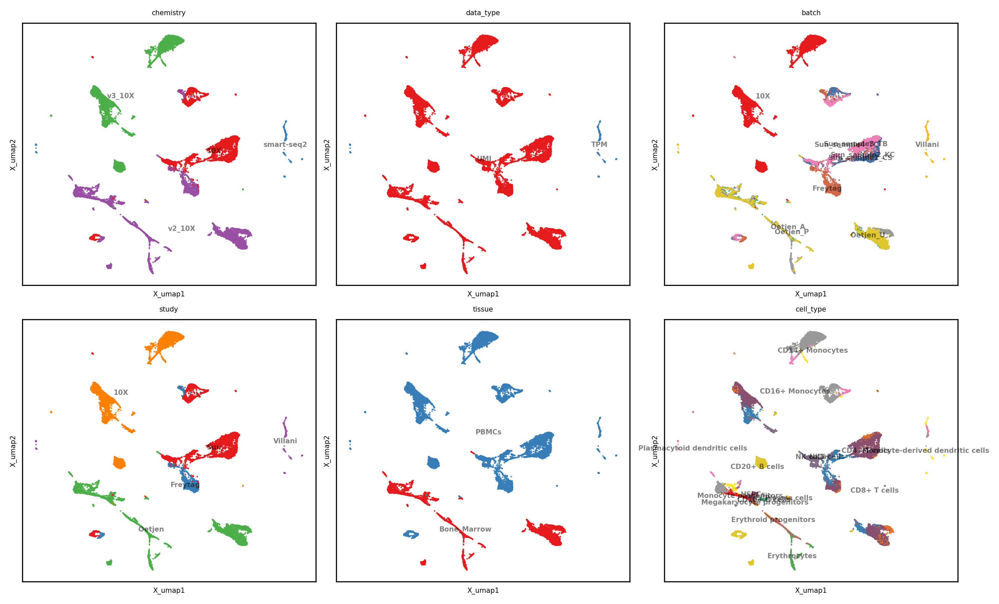

In [17]:
show_basis = 'X_umap'
ccd.pl.plot_embedding(
    adata, show_basis, show_cols, figsize=(10,6), dpi=300, ncols=3, font_size=5, point_size=5, legend_loc='on data',
    save_path=save_dir / f"embeddings_{show_basis}_{file_suffix}.png"
)

### Scanorama

In [14]:
import scanorama

# List of adata per batch
batch_cats = adata.obs.batch.cat.categories
adata_list = [adata[adata.obs.batch == b].copy() for b in batch_cats]
scanorama.integrate_scanpy(adata_list)

adata.obsm["Scanorama"] = np.zeros((adata.shape[0], adata_list[0].obsm["X_scanorama"].shape[1]))
for i, b in enumerate(batch_cats):
    adata.obsm["Scanorama"][adata.obs.batch == b] = adata_list[i].obsm["X_scanorama"]

Found 12303 genes among all datasets
[[0.00000000e+00 9.05288318e-02 1.11755607e-01 4.59418070e-03
  1.17962466e-02 3.42028986e-02 8.76808417e-03 1.66458593e-03
  3.71900826e-03 3.02348337e-01]
 [0.00000000e+00 0.00000000e+00 3.58530027e-03 9.18836141e-04
  1.07238606e-03 6.45217391e-01 2.11310829e-01 3.54645952e-01
  2.26471467e-01 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 5.82366589e-01
  8.89404486e-01 3.47826087e-03 2.19202104e-03 4.16146484e-04
  1.93348801e-03 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
  5.96937213e-01 2.89855072e-03 6.12557427e-04 8.32292967e-04
  1.22511485e-03 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
  0.00000000e+00 3.24637681e-02 4.82244630e-03 1.78942988e-02
  1.12600536e-02 2.25048924e-02]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
  0.00000000e+00 0.00000000e+00 7.90144928e-01 4.16231884e-01
  2.87536232e-01 0.00000000e+00]
 [0.00000000e+00 0.00

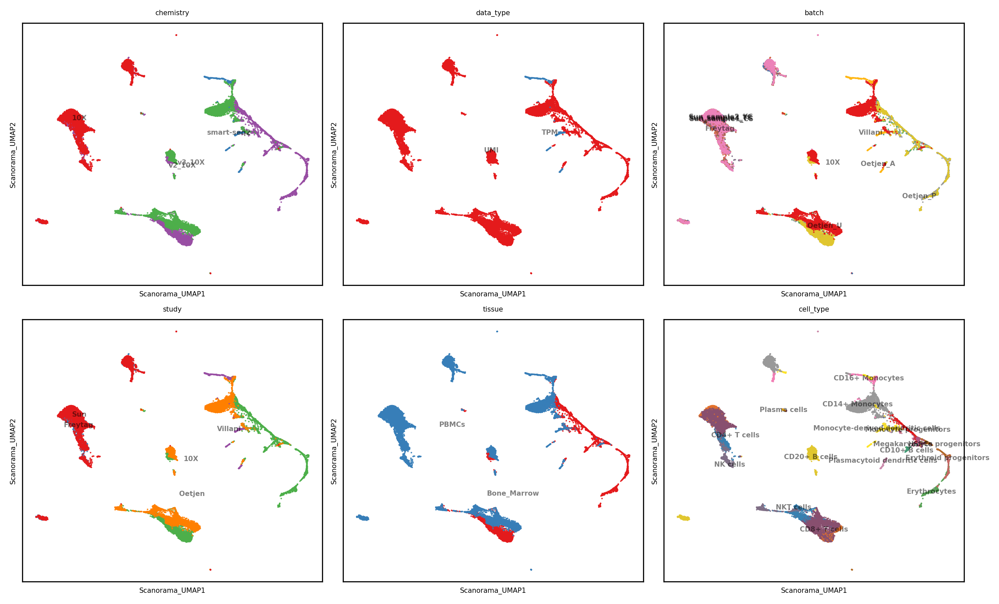

In [16]:
output_key = 'Scanorama'
#ccd.ul.run_umap(adata, source_key=output_key, umap_key=f'{output_key}_UMAP', n_components=2, n_neighbors=30, min_dist=0.1, metric='euclidean', random_state=seed)
show_basis = f'{output_key}_UMAP'
ccd.pl.plot_embedding(
    adata, show_basis, show_cols, figsize=(10,6), dpi=300, ncols=3, font_size=5, point_size=5, legend_loc='on data',
    save_path=save_dir / f"embeddings_{show_basis}_{file_suffix}.png"
)

### Liger

In [18]:
import pyliger
batch_cats = adata.obs.batch.cat.categories
bdata = adata.copy()
# Pyliger normalizes by library size with a size factor of 1
# So here we give it the count data
bdata.X = bdata.layers["counts"]
# List of adata per batch
adata_list = [bdata[bdata.obs.batch == b].copy() for b in batch_cats]
for i, ad in enumerate(adata_list):
    ad.uns["sample_name"] = batch_cats[i]
    # Hack to make sure each method uses the same genes
    ad.uns["var_gene_idx"] = np.arange(bdata.n_vars)

liger_data = pyliger.create_liger(adata_list, remove_missing=False, make_sparse=False)
# Hack to make sure each method uses the same genes
liger_data.var_genes = bdata.var_names
pyliger.normalize(liger_data)
pyliger.scale_not_center(liger_data)
pyliger.optimize_ALS(liger_data, k=30)
pyliger.quantile_norm(liger_data)

adata.obsm["LIGER"] = np.zeros((adata.shape[0], liger_data.adata_list[0].obsm["H_norm"].shape[1]))
for i, b in enumerate(batch_cats):
    adata.obsm["LIGER"][adata.obs.batch == b] = liger_data.adata_list[i].obsm["H_norm"]

100%|██████████| 30/30 [19:38<00:00, 39.29s/it]


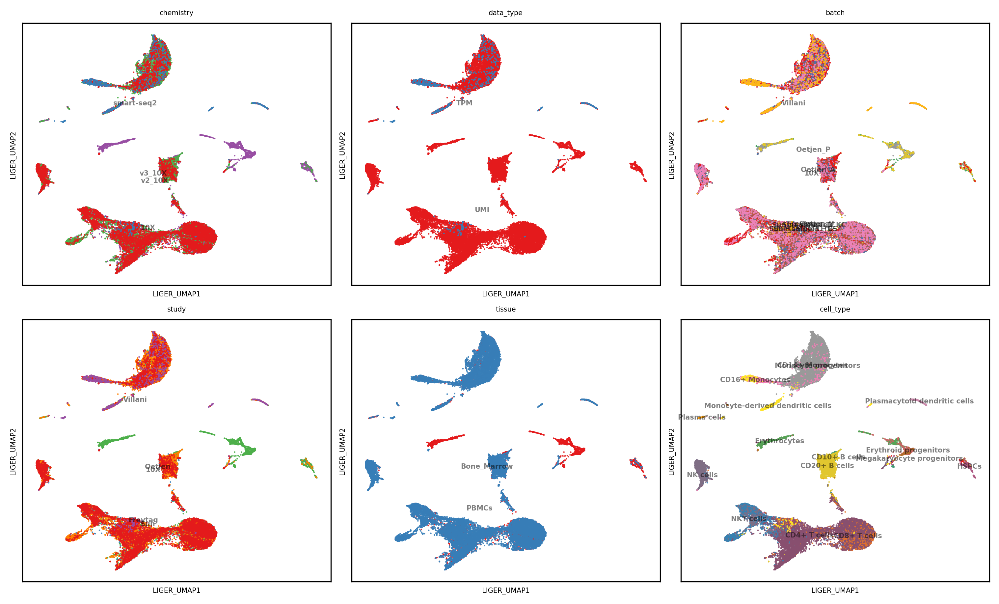

In [24]:
output_key = 'LIGER'
#ccd.ul.run_umap(adata, source_key=output_key, umap_key=f'{output_key}_UMAP', n_components=2, n_neighbors=30, min_dist=0.1, metric='euclidean', random_state=seed)
show_basis = f'{output_key}_UMAP'
ccd.pl.plot_embedding(
    adata, show_basis, show_cols, figsize=(10,6), dpi=300, ncols=3, font_size=5, point_size=5, legend_loc='on data',
    save_path=save_dir / f"embeddings_{show_basis}_{file_suffix}.png"
)

In [20]:
ccd.ul.save_obsm_to_hdf5(adata, save_dir / f"obsm_{file_suffix}.h5")

### Harmony

In [23]:
from harmony import harmonize
output_key = 'Harmony'
adata.obsm[output_key] = harmonize(adata.obsm["X_pca"], adata.obs, batch_key="batch")

	Initialization is completed.
	Completed 1 / 10 iteration(s).
	Completed 2 / 10 iteration(s).
	Completed 3 / 10 iteration(s).
	Completed 4 / 10 iteration(s).
	Completed 5 / 10 iteration(s).
	Completed 6 / 10 iteration(s).
	Completed 7 / 10 iteration(s).
	Completed 8 / 10 iteration(s).
	Completed 9 / 10 iteration(s).
	Completed 10 / 10 iteration(s).


Concord - INFO - UMAP embedding stored in adata.obsm['Harmony_UMAP']


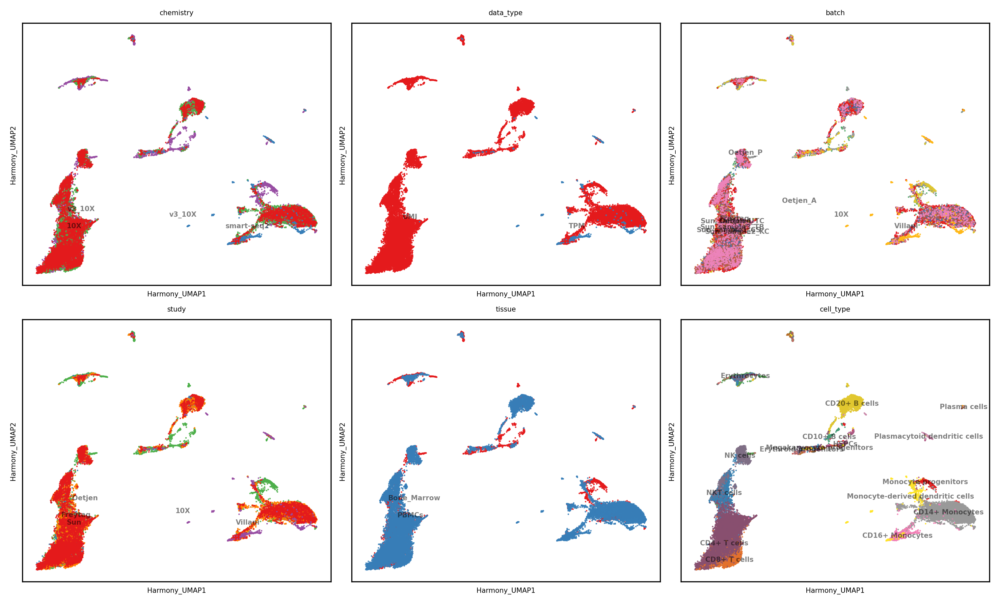

In [25]:
output_key = 'Harmony'
ccd.ul.run_umap(adata, source_key=output_key, umap_key=f'{output_key}_UMAP', n_components=2, n_neighbors=30, min_dist=0.1, metric='euclidean', random_state=seed)
show_basis = f'{output_key}_UMAP'
ccd.pl.plot_embedding(
    adata, show_basis, show_cols, figsize=(10,6), dpi=300, ncols=3, font_size=5, point_size=5, legend_loc='on data',
    save_path=save_dir / f"embeddings_{show_basis}_{file_suffix}.png"
)

### scVI

In [26]:
import scvi

scvi.model.SCVI.setup_anndata(adata, layer="counts", batch_key="batch")
vae = scvi.model.SCVI(adata, gene_likelihood="nb", n_layers=2, n_latent=30)
vae.train()
adata.obsm["scVI"] = vae.get_latent_representation()

An NVIDIA GPU may be present on this machine, but a CUDA-enabled jaxlib is not installed. Falling back to cpu.
Trainer will use only 1 of 4 GPUs because it is running inside an interactive / notebook environment. You may try to set `Trainer(devices=4)` but please note that multi-GPU inside interactive / notebook environments is considered experimental and unstable. Your mileage may vary.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0,1,2,3]


Epoch 239/239: 100%|██████████| 239/239 [13:17<00:00,  3.14s/it, v_num=1, train_loss_step=5.26e+3, train_loss_epoch=4.99e+3]

`Trainer.fit` stopped: `max_epochs=239` reached.


Epoch 239/239: 100%|██████████| 239/239 [13:17<00:00,  3.34s/it, v_num=1, train_loss_step=5.26e+3, train_loss_epoch=4.99e+3]


Concord - INFO - UMAP embedding stored in adata.obsm['scVI_UMAP']


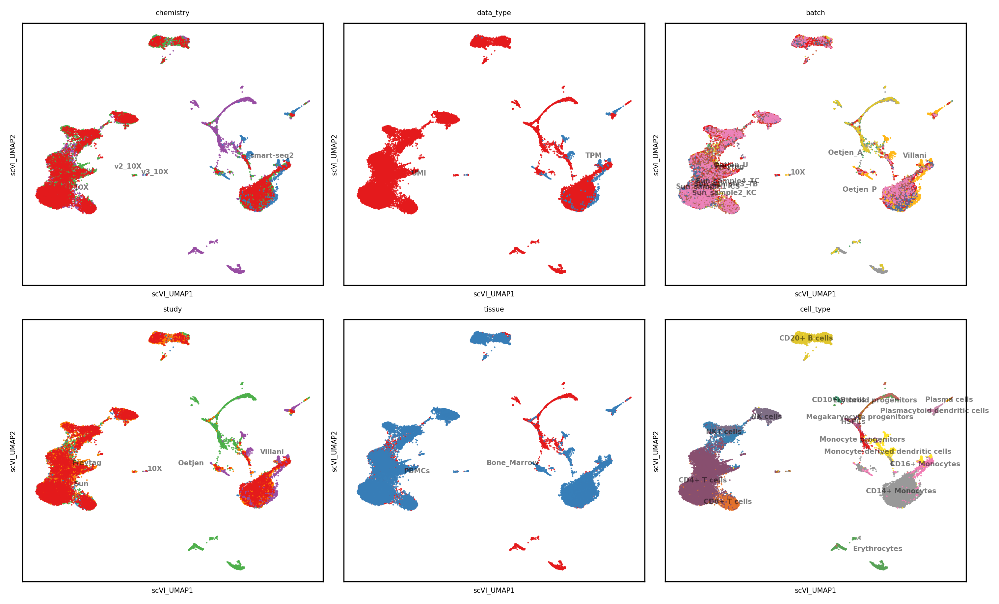

In [28]:
output_key = 'scVI'
ccd.ul.run_umap(adata, source_key=output_key, umap_key=f'{output_key}_UMAP', n_components=2, n_neighbors=30, min_dist=0.1, metric='euclidean', random_state=seed)
show_basis = f'{output_key}_UMAP'
ccd.pl.plot_embedding(
    adata, show_basis, show_cols, figsize=(10,6), dpi=300, ncols=3, font_size=5, point_size=5, legend_loc='on data',
    save_path=save_dir / f"embeddings_{show_basis}_{file_suffix}.png"
)

### scANVI

In [29]:
lvae = scvi.model.SCANVI.from_scvi_model(
    vae,
    adata=adata,
    labels_key="cell_type",
    unlabeled_category="Unknown",
)
lvae.train(max_epochs=20, n_samples_per_label=100)
adata.obsm["scANVI"] = lvae.get_latent_representation()

INFO     Training for 20 epochs.                                                                                   


Trainer will use only 1 of 4 GPUs because it is running inside an interactive / notebook environment. You may try to set `Trainer(devices=4)` but please note that multi-GPU inside interactive / notebook environments is considered experimental and unstable. Your mileage may vary.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0,1,2,3]


Epoch 20/20: 100%|██████████| 20/20 [02:25<00:00,  6.95s/it, v_num=1, train_loss_step=4.13e+3, train_loss_epoch=4.97e+3]

`Trainer.fit` stopped: `max_epochs=20` reached.


Epoch 20/20: 100%|██████████| 20/20 [02:25<00:00,  7.30s/it, v_num=1, train_loss_step=4.13e+3, train_loss_epoch=4.97e+3]


Concord - INFO - UMAP embedding stored in adata.obsm['scANVI_UMAP']


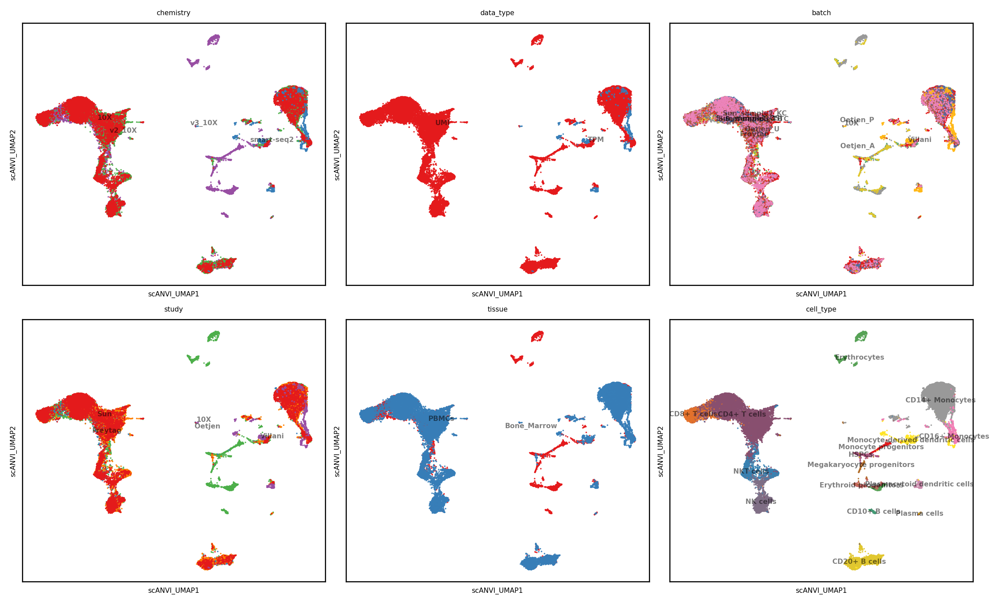

In [30]:
output_key = 'scANVI'
ccd.ul.run_umap(adata, source_key=output_key, umap_key=f'{output_key}_UMAP', n_components=2, n_neighbors=30, min_dist=0.1, metric='euclidean', random_state=seed)
show_basis = f'{output_key}_UMAP'
ccd.pl.plot_embedding(
    adata, show_basis, show_cols, figsize=(10,6), dpi=300, ncols=3, font_size=5, point_size=5, legend_loc='on data',
    save_path=save_dir / f"embeddings_{show_basis}_{file_suffix}.png"
)

### Concord

In [31]:
cur_ccd = ccd.Concord(adata=adata, 
                      input_feature=None, 
                      domain_key='batch', # key indicating batch
                      augmentation_mask_prob = 0.5, # augmentation mask probability, recommend between 0.1 and 0.7
                      clr_temperature = 0.5, # temperature for NT-Xent loss
                      seed=seed, # random seed
                      p_intra_domain = 1.0, # probability of intra-domain sampling
                      verbose=False, # print training progress
                      inplace=True, # whether to modify original adata, set to False if you want to keep all expressions
                      device=device, # device to run on
                      save_dir=save_dir # directory to save model checkpoints
                      ) 

# Encode data, saving the latent embedding in adata.obsm['Concord']
file_suffix = f"{proj_name}_{time.strftime('%b%d-%H%M')}"
output_key = 'Concord'
cur_ccd.encode_adata(input_layer_key='X', output_key=output_key, preprocess=False)
# Save the latent embedding to a file, so that it can be loaded later
ccd.ul.save_obsm_to_hdf5(cur_ccd.adata, save_dir / f"obsm_{file_suffix}.h5")

Concord - WARNING - No input feature list provided. It is recommended to first select features using the command `concord.ul.select_features()`.


Epoch 0 Training: 518it [00:13, 37.83it/s, loss=3.84]
Epoch 4 Training: 100%|██████████| 518/518 [00:06<00:00, 74.78it/s, loss=3.7] 


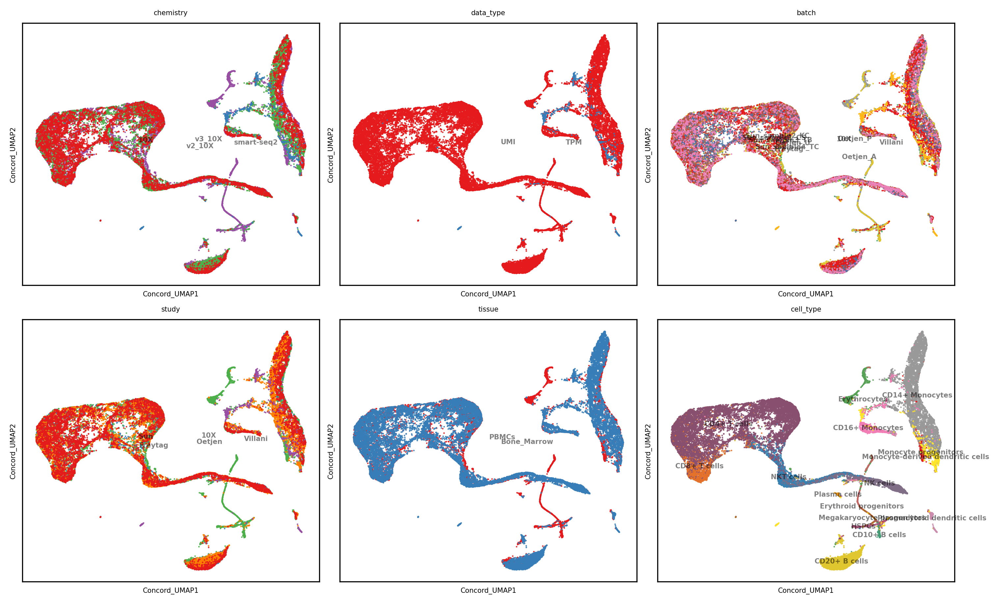

In [35]:
#output_key = 'Concord'
ccd.ul.run_umap(adata, source_key=output_key, umap_key=f'{output_key}_UMAP', n_components=2, n_neighbors=30, min_dist=0.1, metric='euclidean', random_state=seed)
show_basis = f'{output_key}_UMAP'
ccd.pl.plot_embedding(
    adata, show_basis, show_cols, figsize=(10,6), dpi=300, ncols=3, font_size=5, point_size=5, legend_loc='on data',
    save_path=save_dir / f"embeddings_{show_basis}_{file_suffix}.png"
)

In [36]:
ccd.ul.run_umap(adata, source_key=output_key, umap_key=f'{output_key}_UMAP_3D', n_components=3, n_neighbors=30, min_dist=0.1, metric='euclidean', random_state=seed)

col = 'cell_type'
show_basis = f'{output_key}_UMAP_3D'
ccd.pl.plot_embedding_3d(
        adata, basis=show_basis, color_by=col,
        save_path=save_dir / f'{show_basis}_{file_suffix}.html',
        point_size=1, opacity=0.8, width=1500, height=1000
    )


In [37]:
col = 'data_type'
show_basis = f'{output_key}_UMAP_3D'
ccd.pl.plot_embedding_3d(
        adata, basis=show_basis, color_by=col,
        save_path=save_dir / f'{show_basis}_{file_suffix}.html',
        point_size=1, opacity=0.8, width=1500, height=1000
    )

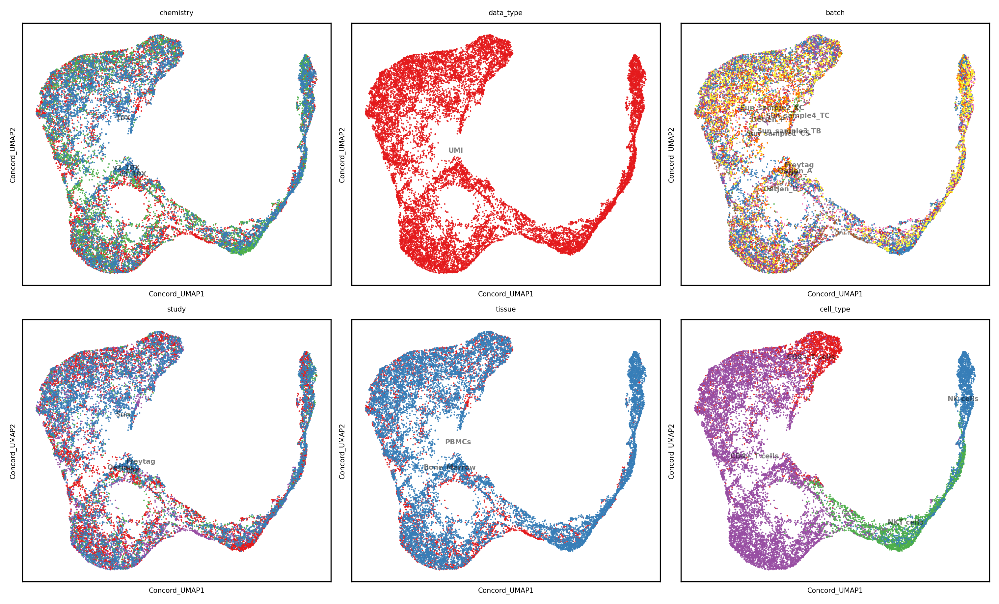

In [38]:
# Local zoom in umap
show_ctypes = ['CD4+ T cells', 'CD8+ T cells', 'NKT cells', 'NK cells']
adata_sub = adata[adata.obs['cell_type'].isin(show_ctypes)]
ccd.ul.run_umap(adata_sub, source_key=output_key, umap_key=f'{output_key}_UMAP', n_components=2, n_neighbors=30, min_dist=0.1, metric='euclidean', random_state=seed)
show_basis = f'{output_key}_UMAP'
ccd.pl.plot_embedding(
    adata_sub, show_basis, show_cols, figsize=(10,6), dpi=300, ncols=3, font_size=5, point_size=5, legend_loc='on data',
    save_path=save_dir / f"embeddings_{show_basis}_{file_suffix}.png"
)

### Concord-ant

In [39]:
cur_ccd = ccd.Concord(adata=adata, 
                      input_feature=None, 
                      domain_key='batch', # key indicating batch
                      augmentation_mask_prob = 0.5, # augmentation mask probability, recommend between 0.1 and 0.7
                      clr_temperature = 0.5, # temperature for NT-Xent loss
                      seed=seed, # random seed
                      p_intra_domain = 1.0, # probability of intra-domain sampling
                      verbose=False, # print training progress
                      inplace=True, # whether to modify original adata, set to False if you want to keep all expressions
                      device=device, # device to run on
                      save_dir=save_dir, # directory to save model checkpoints
                      use_classifier=True, # use classifier
                      class_key = 'cell_type', # key indicating cell type
                      train_frac=0.9 # fraction of data to use for training
                      ) 

# Encode data, saving the latent embedding in adata.obsm['Concord']
file_suffix = f"{proj_name}_{time.strftime('%b%d-%H%M')}"
output_key = 'Concordant'
cur_ccd.encode_adata(input_layer_key='X', output_key=output_key, preprocess=False)
# Save the latent embedding to a file, so that it can be loaded later
ccd.ul.save_obsm_to_hdf5(cur_ccd.adata, save_dir / f"obsm_{file_suffix}.h5")

Concord - WARNING - No input feature list provided. It is recommended to first select features using the command `concord.ul.select_features()`.
Concord - WARNING - Nearest neighbor contrastive loss is currently not supported for training fraction less than 1.0. Setting p_intra_knn to 0.


Epoch 0 Training: 467it [00:06, 68.92it/s, loss=4.41]
Epoch 0 Validation: 46it [00:00, 109.92it/s, loss=4.69]
Epoch 4 Validation: 100%|██████████| 46/46 [00:00<00:00, 112.16it/s, loss=3.6] 


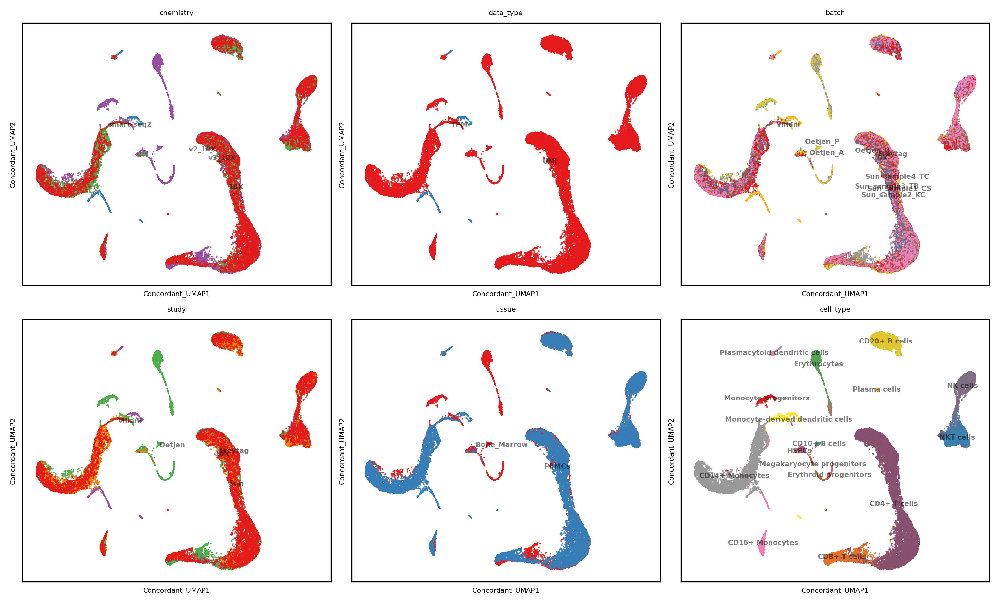

In [42]:
#ccd.ul.run_umap(adata, source_key=output_key, umap_key=f'{output_key}_UMAP', n_components=2, n_neighbors=30, min_dist=0.1, metric='euclidean', random_state=seed)
show_basis = f'{output_key}_UMAP'
ccd.pl.plot_embedding(
    adata, show_basis, show_cols, figsize=(10,6), dpi=300, ncols=3, font_size=5, point_size=5, legend_loc='on data',
    save_path=save_dir / f"embeddings_{show_basis}_{file_suffix}.png"
)

In [43]:
obsm_filename = save_dir / f"obsm_{file_suffix}.h5"
ccd.ul.save_obsm_to_hdf5(adata, obsm_filename)
adata.write_h5ad( save_dir / f"adata_{file_suffix}.h5ad")

### Benchmarking

In [46]:
bm = Benchmarker(
    adata,
    batch_key="batch",
    label_key="cell_type",
    embedding_obsm_keys=["Unintegrated", "Scanorama", "LIGER", "Harmony", "scVI", "Concord", "Concordant", "scANVI"],
    n_jobs=6,
)
bm.benchmark()

Embeddings: 100%|██████████| 8/8 [12:42<00:00, 95.25s/it] 


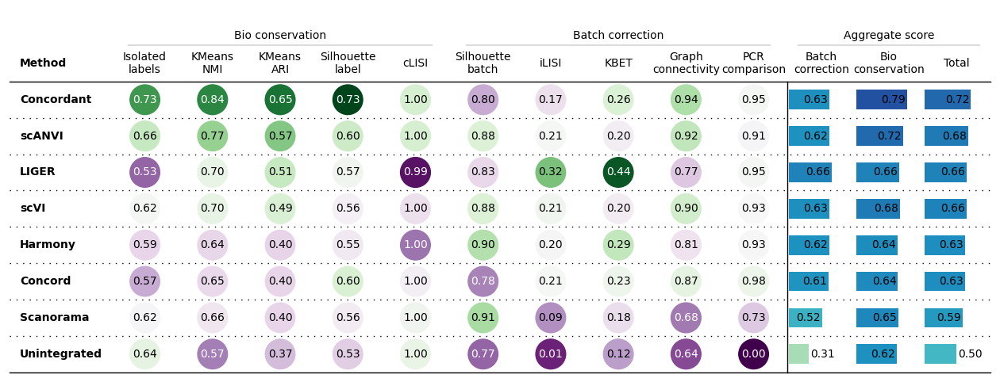

In [47]:
import matplotlib.pyplot as plt
import os
bm.plot_results_table(min_max_scale=False, show=False)
fig = plt.gcf()
fig.set_size_inches(16, 6) 
fig.savefig(os.path.join(save_dir, f'scibmetrics_results_{file_suffix}.pdf'), facecolor='white', dpi=600)
plt.show()
plt.close(fig)

## Hyperparameter test

In [ ]:
# Batch run
param_grid = {
    #"augmentation_mask_prob": [0.0, 0.1, 0.3, 0.5, 0.7, 0.9],
    #"p_intra_knn": [0.0, 0.05, 0.1, 0.3, 0.5],
    #"min_p_intra_domain": [0.3, 0.5, 0.8, 1.0],
    "dropout_prob": [0.0, 0.1, 0.3, 0.5],
}
ccd.ul.run_hyperparameter_tests(adata, params, param_grid, output_key='Concord', return_decoded=False, trace_memory=True, trace_gpu_memory=True, save_dir=save_dir)


In [ ]:

params_cdt = params.copy()
params_cdt['use_classifier'] = True
param_grid = {
    "augmentation_mask_prob": [0.0, 0.1, 0.3, 0.5, 0.7, 0.9],
    "p_intra_knn": [0.0, 0.05, 0.1, 0.3, 0.5],
    "min_p_intra_domain": [0.3, 0.5, 0.8, 1.0],
}
ccd.ul.run_hyperparameter_tests(adata, params_cdt, param_grid, output_key='Concord-ant', return_decoded=False, trace_memory=True, trace_gpu_memory=True, save_dir=save_dir)


In [ ]:
# keys_to_delete = [key for key in adata.obsm.keys() if 'dropout' in key]

# for key in keys_to_delete:
#     del adata.obsm[key]
[key for key in adata.obsm.keys() if all(substring not in key for substring in ["UMAP"])]

In [ ]:

file_suffix = f"{time.strftime('%b%d-%H%M')}"
bm = Benchmarker(
    adata,
    batch_key="batch",
    label_key="cell_type",
    embedding_obsm_keys= [key for key in adata.obsm.keys() if all(substring not in key for substring in ["UMAP"])],
    n_jobs=6
)
bm.benchmark()
ccd.ul.save_object(bm, save_dir / f"bm_{file_suffix}.pkl")
bm.get_results(min_max_scale=False).to_excel(save_dir / f"bm_results_{file_suffix}.xlsx")


In [ ]:

import matplotlib.pyplot as plt
import os
bm.plot_results_table(min_max_scale=False, show=False)
fig = plt.gcf()
fig.set_size_inches(25, 4) 
fig.savefig(os.path.join(save_dir, f'scibmetrics_results_{file_suffix}.pdf'), facecolor='white', dpi=300)
plt.show()
plt.close(fig)


In [58]:

obsm_filename = save_dir / f"obsm_{file_suffix}.h5"
ccd.ul.save_obsm_to_hdf5(adata, obsm_filename)
adata.write_h5ad( save_dir / f"adata_{file_suffix}.h5ad")

In [ ]:
output_key = "Concord_dropout_prob_0.5"
ccd.ul.run_umap(adata, source_key=output_key, umap_key=f'{output_key}_UMAP', n_components=2, n_epochs=500, n_neighbors=15, min_dist=0.0, metric='euclidean', random_state=seed, use_cuml=False)

show_emb = f'{output_key}_UMAP'
ccd.pl.plot_embedding(
    adata, show_emb, show_cols, figsize=(10,7), dpi=600, ncols=3, font_size=5, point_size=2, legend_loc='on data',
    save_path=save_dir / f"embeddings_{show_emb}_{file_suffix}.png"
)

In [ ]:
from Concord.utils.sparsity import plot_sparsity_by_batch
plot_sparsity_by_batch(adata, batch_column = 'chemistry')